# Collisions Graph - mapping collisions to road networks

__Last update: June 2022__

This notebook provides an alternative to the method analysed in `clustering-collisions.ipynb`. Instead of clustering collisions together, we want to map collisions back to existing open source data on junctions.

I've found two sources we could use to map out junctions across London.

### Option 1 - https://github.com/AndGem/OsmToRoadGraph

I pulled the data for this source using:
`python run.py -f data/greater-london-latest.osm -n c --networkx`

You can modify the configuration.py file to remove certain road types etc. and I've used the car option (`c`) since it's mostly junctions which cars can use we're interested in.

### Option 2 - https://github.com/gboeing/osmnx

This second source is from the same raw data (AFAIK). This package allows us to read in the data directly into a graph object, which makes it easier to process. Plus there are some functions for simplifying the road network which might be useful.

__IDEAS / NOTES:__

- Clean up function works, but it deosn't do anything to leave in more major connections - how could we adapt it? One way would be to remove nodes with low degree.

__TODO:__ clean up imports - don't think all are needed?

In [1]:
import json
import os
import geopandas
import pandas as pd
import seaborn as sns
import osmnx as ox
import contextily as cx
import matplotlib.pyplot as plt

# this prevents a lot of future warnings that are coming out of oxmnx
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from scipy import spatial
from ipyleaflet import basemaps, Marker, Map
from dotenv import load_dotenv

load_dotenv()
os_api_key = os.getenv('OS_API_KEY')

%config InlineBackend.figure_format = 'retina'

sns.set_palette('Dark2')
plt.rcParams["font.family"] = "Calibri"
plt.rcParams["font.size"] = 12

In [2]:
def get_nearest_junction(row, tree):
    crash_coordinate = row[['latitude', 'longitude']].values
    result = tree.query(crash_coordinate)

    distance = result[0]
    junction_id = result[1]
    return distance, junction_id


def weight_accident_severity(severity):
    '''
    Upweights more severe collisions for junction comparison.
    '''
    if severity == 'Fatal':
        return 3
    if severity == 'Serious':
        return 1
    else:
        return 0

# 1. Read in collision data

`../data/london-crashes.csv` filter to serious and fatal collisions only.

In [3]:
# not a massive fan of the use of the term 'accidents'
collisions = pd.read_csv('../data/london-crashes.csv')

collisions.rename(columns={'accident_index': 'id'}, inplace=True)

collisions = collisions[
    (collisions['max_cyclist_severity'] != 'Slight') &
    (collisions['junction_detail'] != 'Private drive or entrance')
]

collisions['collision_metric'] = collisions['accident_severity'].apply(weight_accident_severity)

# example rows
collisions.sample(5)

,id,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,datetime,max_cyclist_severity,collision_metric
11502,200601GD10050,2006,01GD10050,533540.0,184890.0,-0.075507,51.547056,Metropolitan Police,Serious,2,...,Dry,None,None,Urban,No,Non-trunk,E01001743,2006-02-08T13:30:00Z,Serious,1
47192,2019010220554,2019,010220554,529652.0,180656.0,-0.133099,51.509967,Metropolitan Police,Serious,2,...,Dry,None,None,Urban,Yes,Non-trunk,E01004736,2019-11-24T19:32:00Z,Serious,1
46994,2019010214020,2019,010214020,535598.0,186054.0,-0.045392,51.557081,Metropolitan Police,Serious,2,...,Dry,None,None,Rural,Yes,Non-trunk,E01001787,2019-10-25T20:00:00Z,Serious,1
42302,2018010095051,2018,010095051,527840.0,179410.0,-0.159647,51.499182,Metropolitan Police,Serious,2,...,Dry,None,None,Urban,No,Non-trunk,E01002818,2018-02-23T10:55:00Z,Serious,1
27910,201301EK40393,2013,01EK40393,530640.0,181230.0,-0.118663,51.514843,Metropolitan Police,Serious,2,...,Dry,None,None,Urban,Yes,Non-trunk,E01000918,2013-07-09T16:20:00Z,Serious,1


# 2. Load in option 1 junction graph

Stored in `../data/greater-london-latest.json`, which is from the output of this command: `python run.py -f data/greater-london-latest.osm -n c --networkx`

In [4]:
with open('../data/greater-london-latest.json') as f:
    d = json.load(f)

print(d.keys())

junctions_opt_1 = pd.DataFrame(d['nodes'])
junctions_opt_1.rename(
    columns={
        'lat': 'latitude',
        'lon': 'longitude',
        'id': 'junction_id'
    },
    inplace=True
)

del d

print(f'{len(junctions_opt_1)} junctions')
junctions_opt_1.sample(5)

dict_keys(['directed', 'multigraph', 'graph', 'nodes', 'adjacency'])
186846 junctions


,latitude,longitude,junction_id
27344,51.575882,-0.358218,27344
94204,51.518502,0.190313,94204
107711,51.477155,0.163369,107711
64653,51.554347,-0.054099,64653
46741,51.609153,-0.365441,46741


# 3. Load in option 2 junction graph

Using `osmnx` package, which we can read in as a networkx graph object.

Simplify graph using the `consolidate_intersections` function.

See plot of simplified local example, before I pull full London network. It takes a while to process.

Nodes: 563


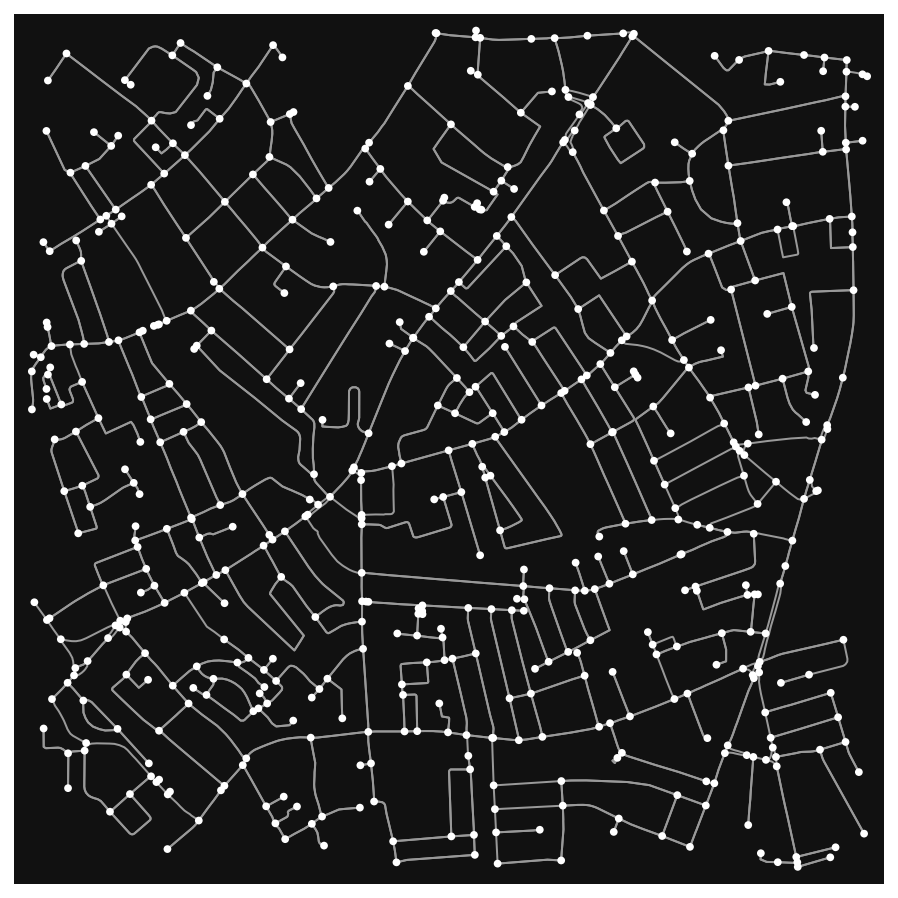

Nodes: 388


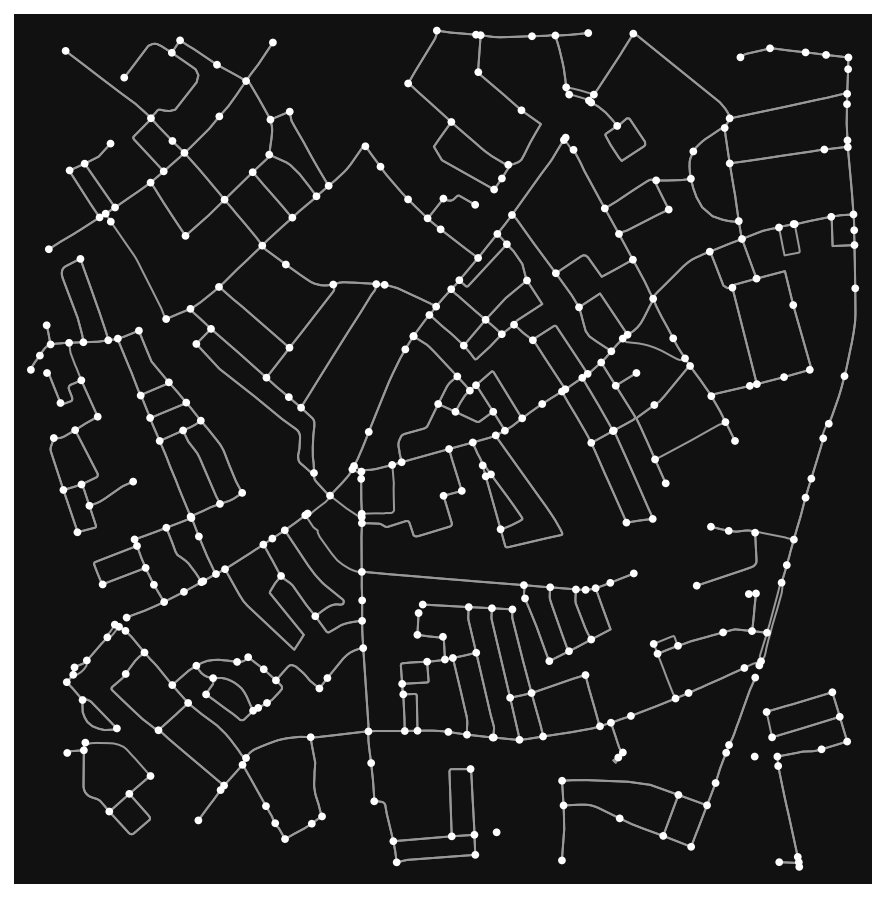

Nodes: 257


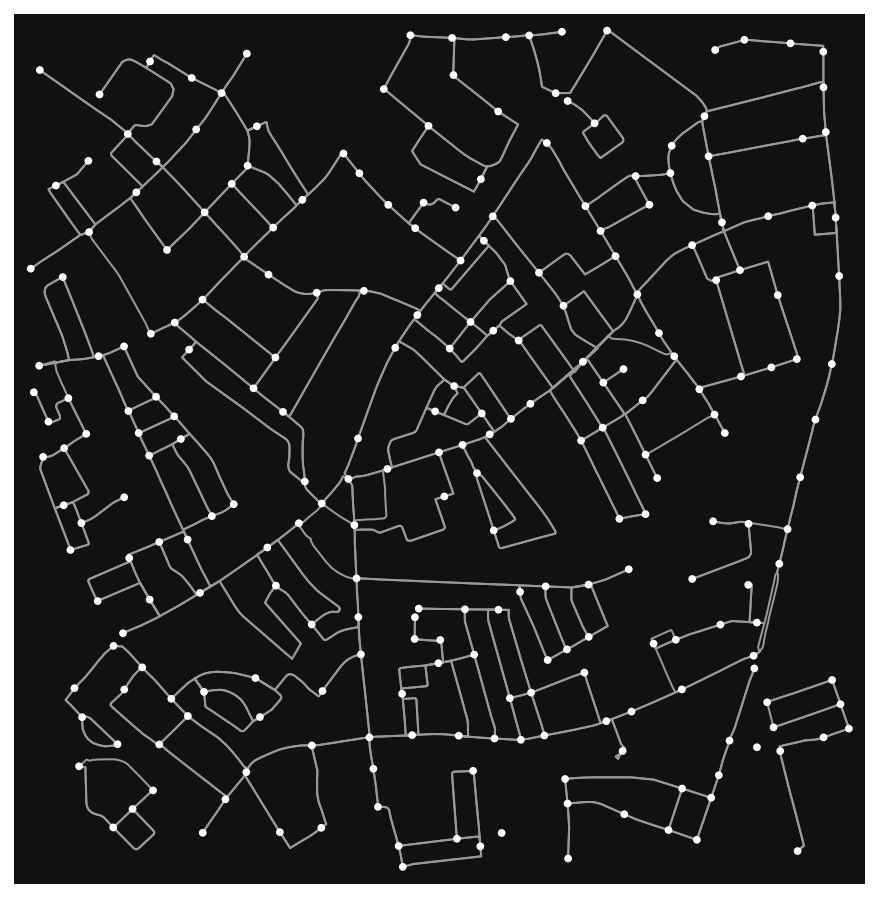

In [5]:
test_G = ox.graph_from_address('Landor Road, London, UK', network_type='drive')

print(f'Nodes: {len(test_G.nodes)}')
ox.plot_graph(test_G)

# Remove nodes with low degree

nodes_to_remove = [node for node,degree in dict(test_G.degree()).items() if degree <= 3]
test_G.remove_nodes_from(nodes_to_remove)

print(f'Nodes: {len(test_G.nodes)}')
ox.plot_graph(test_G);

test_G = ox.consolidate_intersections(
    ox.project_graph(test_G),
    tolerance=25,  # combines junctions within 25m
    rebuild_graph=True,
    dead_ends=False
)

print(f'Nodes: {len(test_G.nodes)}')
ox.plot_graph(test_G);

In [6]:
G = ox.graph_from_address(
    'London, UK',
    dist=15000,
    network_type='drive'
)
print(f'Nodes: {len(G.nodes)}')

# Remove nodes with low degree

nodes_to_remove = [node for node,degree in dict(G.degree()).items() if degree <= 2]
G.remove_nodes_from(nodes_to_remove)
print(f'Nodes: {len(G.nodes)}')

G = ox.consolidate_intersections(
    ox.project_graph(G),
    tolerance=35,
    rebuild_graph=True,
    dead_ends=False
)
print(f'Nodes: {len(G.nodes)}')

ids, lats, lons = [], [], []

n = 0
for node in G.nodes(data=True):
    try:
        lons.append(node[1]['lon'])
        lats.append(node[1]['lat'])
        ids.append(n)
        n += 1
    except:
        continue

junctions_opt_2 = pd.DataFrame({
    'latitude': lats,
    'longitude': lons,
    'junction_id': ids
})

junctions_opt_2

Nodes: 88225
Nodes: 67153
Nodes: 24925


,latitude,longitude,junction_id
0,51.535179,-0.148104,0
1,51.528960,-0.145843,1
2,51.537513,-0.152666,2
3,51.537330,-0.154627,3
4,51.534054,-0.162657,4
...,...,...,...
13935,51.499592,0.031538,13935
13936,51.560109,-0.280631,13936
13937,51.375017,-0.278856,13937
13938,51.395847,-0.020291,13938


## 3.1 Plot junctions map

See if simplification at right level...

`tolerance=50` was definitely too high, `tolerance=25` seems like okay compromise. Also dependent on the initial `dist` parameter, since that sets the initital number of nodes.

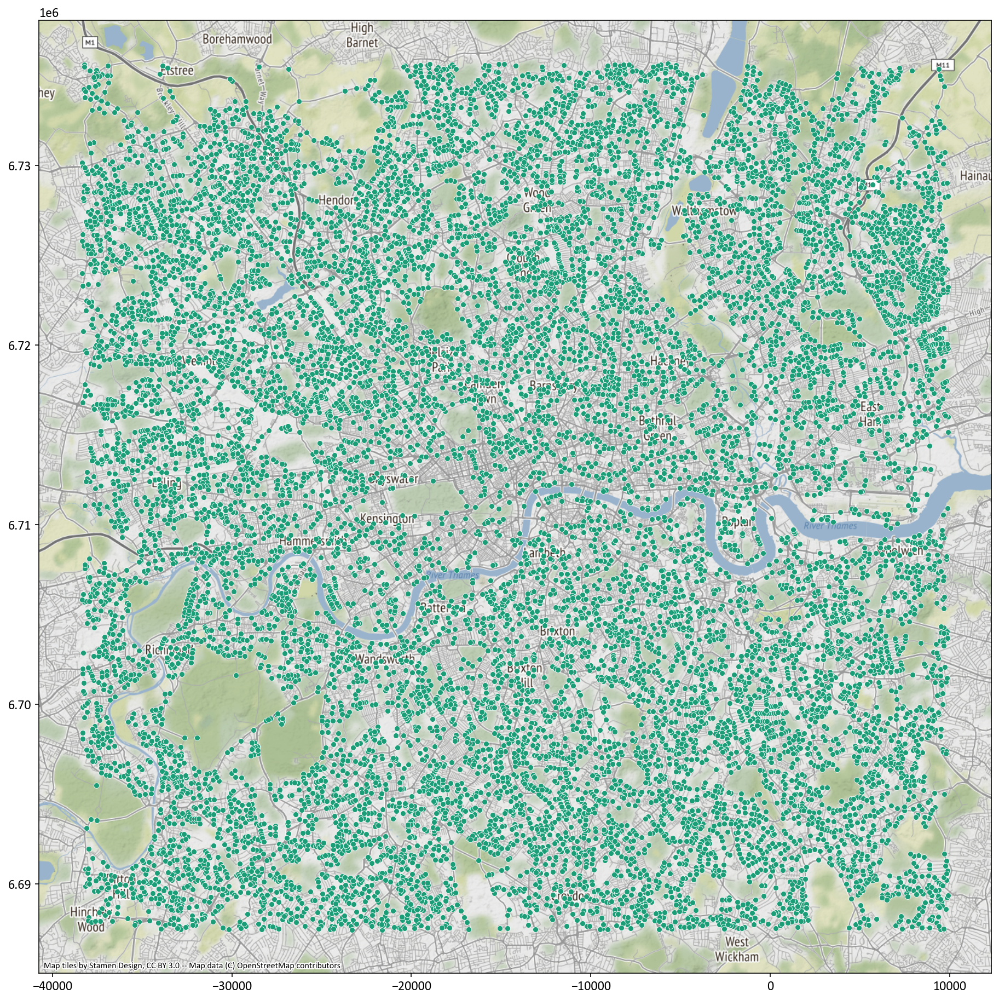

In [7]:
gpd_junctions_opt_2 = geopandas.GeoDataFrame(
    junctions_opt_2,
    geometry=geopandas.points_from_xy(junctions_opt_2.longitude, junctions_opt_2.latitude, crs="EPSG:4326")
)

gpd_junctions_opt_2.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junctions_opt_2.geometry.x,
    y=gpd_junctions_opt_2.geometry.y,
    alpha=1,
    s=25
);

cx.add_basemap(ax)

# 4. Assign collisions to junctions

Now we have two junction graphs we want to assign collisions to a junction based on the closest one.

https://en.wikipedia.org/wiki/K-d_tree

In [8]:
# create k-d trees..
tree_opt_1 = spatial.KDTree(junctions_opt_1[['latitude', 'longitude']])
tree_opt_2 = spatial.KDTree(junctions_opt_2[['latitude', 'longitude']])

collisions[['distance_opt_1', 'junction_id_opt_1']] = collisions.apply(
    lambda row: get_nearest_junction(row, tree_opt_1), axis=1, result_type='expand'
)
collisions[['distance_opt_2', 'junction_id_opt_2']] = collisions.apply(
    lambda row: get_nearest_junction(row, tree_opt_2), axis=1, result_type='expand'
)

collisions.sample(5)

,id,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,datetime,max_cyclist_severity,collision_metric,distance_opt_1,junction_id_opt_1,distance_opt_2,junction_id_opt_2
32925,201401TD00039,2014,01TD00039,531970.0,178840.0,-0.100400,51.493056,Metropolitan Police,Fatal,2,...,Yes,Non-trunk,E01032719,2014-05-13T15:05:00Z,NaN,3,0.000158,98498.0,0.002273,6777.0
7897,200401EO01498,2004,01EO01498,530290.0,182640.0,-0.123183,51.527595,Metropolitan Police,Serious,2,...,Yes,Non-trunk,E01000941,2004-10-17T09:20:00Z,Serious,1,0.001236,155962.0,0.001614,5608.0
22515,201101LX50451,2011,01LX50451,529050.0,174700.0,-0.143949,51.456523,Metropolitan Police,Serious,2,...,No,Non-trunk,E01003026,2011-06-26T12:30:00Z,Serious,1,0.000031,73574.0,0.001688,2644.0
23797,201101TB01556,2011,01TB01556,531160.0,184280.0,-0.110038,51.542132,Metropolitan Police,Serious,2,...,No,Non-trunk,E01002700,2011-11-07T18:45:00Z,Serious,1,0.000077,528.0,0.001430,141.0
49945,2020010281892,2020,010281892,528690.0,179380.0,-0.147419,51.498720,Metropolitan Police,Serious,2,...,Yes,Non-trunk,E01004731,2020-11-30T15:30:00Z,Serious,1,0.000075,105693.0,0.002131,3713.0


# 5. Join data to nearest junction and summarise

Do we need a maximum distance filter?

Maximum distance filter needed for opt 2 as the network doesn't extend out far enough relative to the collision data yet.

,junction_id,latitude_junction,longitude_junction,collision_metric
3811,137032,51.514036,-0.104365,10
411,6500,51.497070,-0.099305,9
4888,178978,51.510935,-0.066970,9
2694,96795,51.518901,-0.121263,7
332,4776,51.506223,-0.209100,7
2193,72056,51.529522,-0.013671,6
3047,106938,51.472951,0.003266,6
2311,80765,51.501157,-0.078131,6
3597,127536,51.537702,-0.060773,6
4515,162964,51.427624,-0.133688,6


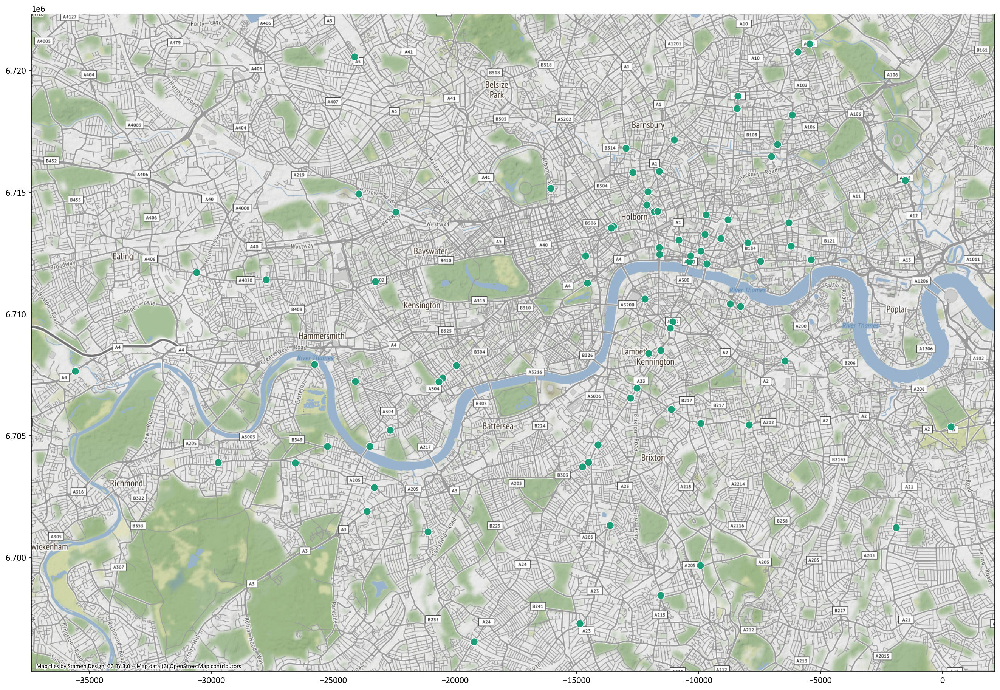

In [9]:
n = 80

junctions_stats_opt_1 = (
    collisions
    .merge(junctions_opt_1, how='left', left_on='junction_id_opt_1', right_on='junction_id')
    .groupby(['junction_id', 'latitude_y', 'longitude_y'])['collision_metric']
    .sum()
    .reset_index()
    .rename(columns={'latitude_y': 'latitude_junction', 'longitude_y': 'longitude_junction'})
    .sort_values(by='collision_metric', ascending=False)
    .head(n)
)

display(junctions_stats_opt_1.head(10))

gpd_junctions_stats_opt_1 = geopandas.GeoDataFrame(
    junctions_stats_opt_1,
    geometry=geopandas.points_from_xy(
        junctions_stats_opt_1.longitude_junction,
        junctions_stats_opt_1.latitude_junction,
        crs="EPSG:4326"
    )
)

gpd_junctions_stats_opt_1.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junctions_stats_opt_1.geometry.x,
    y=gpd_junctions_stats_opt_1.geometry.y,
    alpha=1,
    s=100
);

cx.add_basemap(ax)

del gpd_junctions_stats_opt_1

## 5.1 Plot distances distribution for option 2

To help decide cut off value, set to `< .002`

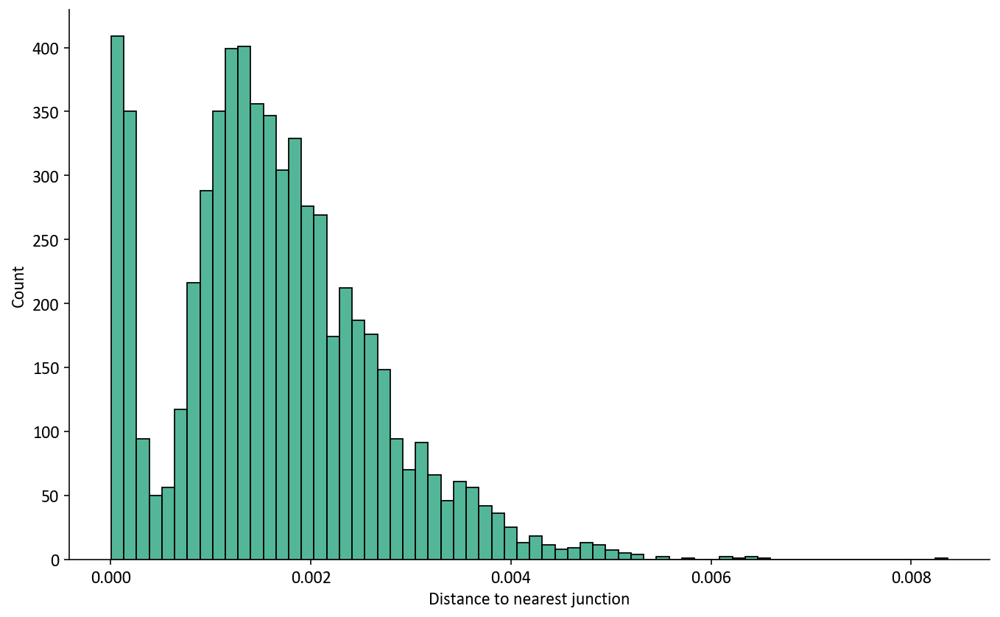

In [10]:
sns.displot(
    collisions.distance_opt_2,
    height=6,
    aspect=1.6
)
plt.xlabel('Distance to nearest junction');

,junction_id,latitude_junction,longitude_junction,collision_metric
869,4276,51.515278,-0.104568,24
148,271,51.522663,-0.078999,21
1124,6777,51.495066,-0.099338,19
603,2648,51.482773,-0.113476,19
1211,7590,51.515666,-0.073403,18
1195,7400,51.432380,-0.165630,18
596,2639,51.513905,-0.087281,14
52,90,51.535650,-0.062314,14
91,159,51.496068,-0.125416,14
20,29,51.521151,-0.114729,14


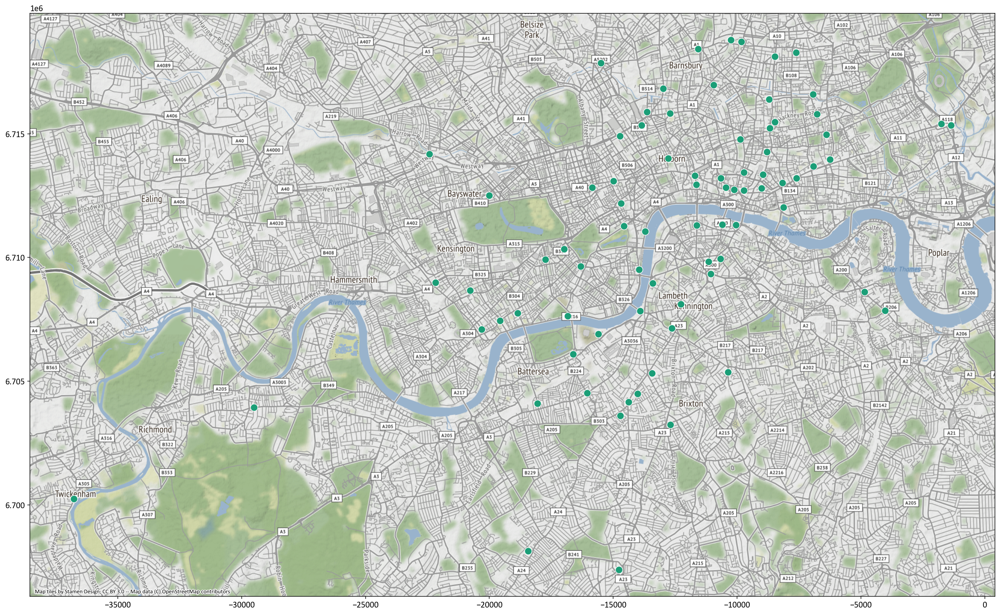

In [16]:
n = 80

junctions_stats_opt_2 = (
    collisions
    [collisions.distance_opt_2 < .002]
    .merge(junctions_opt_2, how='left', left_on='junction_id_opt_2', right_on='junction_id')
    .groupby(['junction_id', 'latitude_y', 'longitude_y'])['collision_metric']
    .sum()
    .reset_index()
    .rename(columns={'latitude_y': 'latitude_junction', 'longitude_y': 'longitude_junction'})
    .sort_values(by='collision_metric', ascending=False)
    .head(n)
)

display(junctions_stats_opt_2.head(10))

gpd_junctions_stats_opt_2 = geopandas.GeoDataFrame(
    junctions_stats_opt_2,
    geometry=geopandas.points_from_xy(
        junctions_stats_opt_2.longitude_junction,
        junctions_stats_opt_2.latitude_junction,
        crs="EPSG:4326"
    )
)

gpd_junctions_stats_opt_2.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junctions_stats_opt_2.geometry.x,
    y=gpd_junctions_stats_opt_2.geometry.y,
    alpha=1,
    s=100
);

cx.add_basemap(ax)

del gpd_junctions_stats_opt_2

# Traffic volume data

Not quite sure how to combine this in yet.

,latitude,longitude,all_motor_vehicles,geometry
965,51.530292,-0.086330,328604,POINT (-9610.190 6715637.773)
260,51.485499,-0.124790,129989,POINT (-13891.589 6707626.394)
420,51.497662,-0.148783,438113,POINT (-16562.470 6709801.065)
1044,51.538203,-0.142092,375765,POINT (-15817.576 6717053.423)
802,51.519543,-0.145013,42697,POINT (-16142.807 6713714.557)


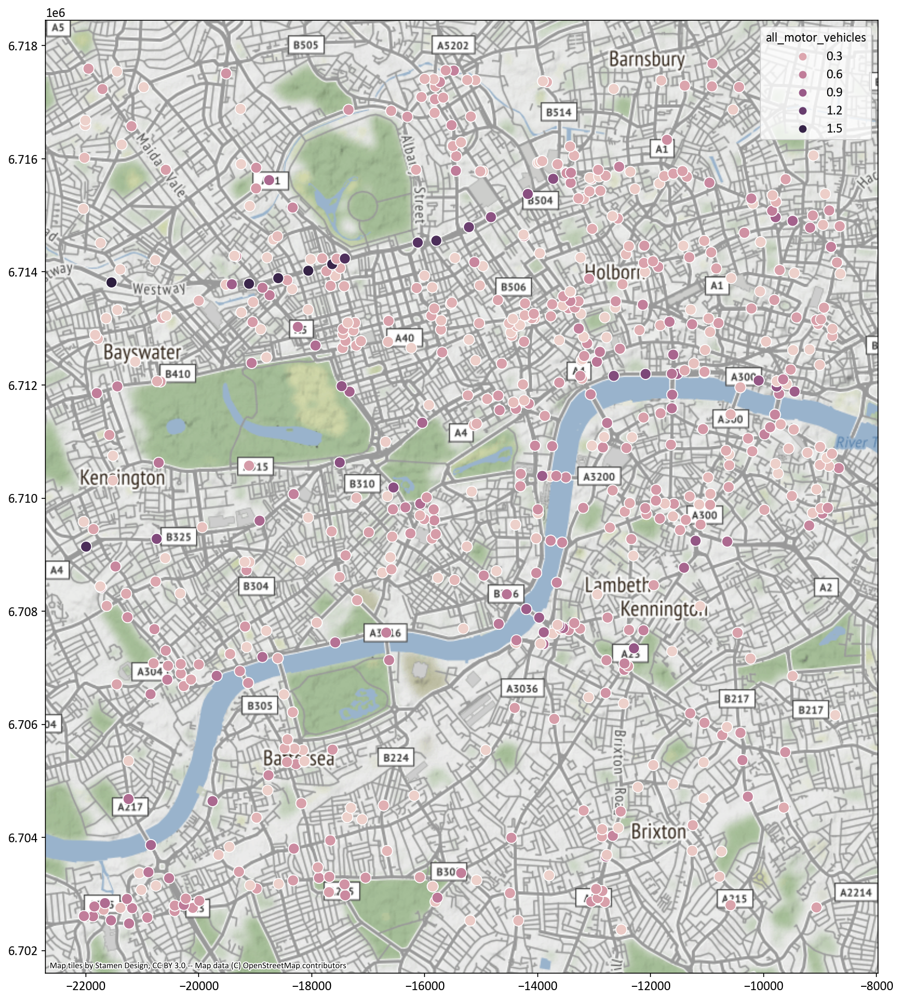

In [17]:
raw_volumes = pd.read_csv('../data/dft_aadfbydirection_region_id_6.csv')

# filter to London area
# 51.455953, 51.541914
# -.198716, -.077560

raw_volumes = raw_volumes[
    (raw_volumes['longitude'] >= -.198716) &
    (raw_volumes['longitude'] <= -.077560) &
    (raw_volumes['latitude'] >= 51.455953) &
    (raw_volumes['latitude'] <= 51.541914)
]

volumes = (
    raw_volumes
    .groupby([
        'latitude',
        'longitude'
#         , 'direction_of_travel'
    ])['all_motor_vehicles']
    .sum()
    .reset_index()
)

del raw_volumes

gpd_volumes = geopandas.GeoDataFrame(
    volumes,
    geometry=geopandas.points_from_xy(
        volumes.longitude,
        volumes.latitude,
        crs="EPSG:4326"
    )
)

gpd_volumes.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_volumes.geometry.x,
    y=gpd_volumes.geometry.y,
    hue=gpd_volumes.all_motor_vehicles,
    alpha=1,
    s=100
);

cx.add_basemap(ax)

del gpd_volumes

volumes.sample(5)